# Metro Interstate Traffic Volume
https://archive.ics.uci.edu/dataset/492/metro+interstate+traffic+volume

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error, mean_squared_error, r2_score

from supervised.automl import AutoML

%matplotlib inline

Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)


### Dataset

In [2]:
data = pd.read_csv('../../data/metro+interstate+traffic+volume.csv')
target_variable = 'traffic_volume'
print(data.shape)
data.head()

(48204, 9)


,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main,weather_description,date_time,traffic_volume
0,NaN,288.28,0.0,0.0,40,Clouds,scattered clouds,2012-10-02 09:00:00,5545
1,NaN,289.36,0.0,0.0,75,Clouds,broken clouds,2012-10-02 10:00:00,4516
2,NaN,289.58,0.0,0.0,90,Clouds,overcast clouds,2012-10-02 11:00:00,4767
3,NaN,290.13,0.0,0.0,90,Clouds,overcast clouds,2012-10-02 12:00:00,5026
4,NaN,291.14,0.0,0.0,75,Clouds,broken clouds,2012-10-02 13:00:00,4918


In [3]:
data.info();

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48204 entries, 0 to 48203
Data columns (total 9 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   holiday              61 non-null     object 
 1   temp                 48204 non-null  float64
 2   rain_1h              48204 non-null  float64
 3   snow_1h              48204 non-null  float64
 4   clouds_all           48204 non-null  int64  
 5   weather_main         48204 non-null  object 
 6   weather_description  48204 non-null  object 
 7   date_time            48204 non-null  object 
 8   traffic_volume       48204 non-null  int64  
dtypes: float64(3), int64(2), object(4)
memory usage: 3.3+ MB


In [4]:
data['holiday'].value_counts()

holiday
Labor Day                    7
Thanksgiving Day             6
Christmas Day                6
New Years Day                6
Martin Luther King Jr Day    6
Columbus Day                 5
Veterans Day                 5
Washingtons Birthday         5
Memorial Day                 5
Independence Day             5
State Fair                   5
Name: count, dtype: int64

In [5]:
#fill the na on holiday with None
data.loc[data['holiday'].isna(), 'holiday'] = 'None'

In [6]:
data.isna().values.sum()

0

In [7]:
# data[['weather_main', 'weather_description']].value_counts()
data[['weather_main']].value_counts()

weather_main
Clouds          15164
Clear           13391
Mist             5950
Rain             5672
Snow             2876
Drizzle          1821
Haze             1360
Thunderstorm     1034
Fog               912
Smoke              20
Squall              4
Name: count, dtype: int64

In [8]:
# add hours to the date tiem field
data['date_time'] = pd.to_datetime(data['date_time'])
# data['Date'] = pd.to_datetime(dict(year=data['Date'].dt.year, month=data['Date'].dt.month, day=data['Date'].dt.day, hour=data['Hour']))
data['year'] = data['date_time'].dt.year
data['month'] = data['date_time'].dt.month
data['day_of_month'] = data['date_time'].dt.day
data['day_of_week'] = data['date_time'].dt.day_of_week
data['hour_of_day'] = data['date_time'].dt.hour
data[['hour_of_day', 'day_of_week', 'day_of_month', 'month', 'year']] = data[['hour_of_day', 'day_of_week', 'day_of_month', 'month', 'year']].astype('category')
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48204 entries, 0 to 48203
Data columns (total 14 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   holiday              48204 non-null  object        
 1   temp                 48204 non-null  float64       
 2   rain_1h              48204 non-null  float64       
 3   snow_1h              48204 non-null  float64       
 4   clouds_all           48204 non-null  int64         
 5   weather_main         48204 non-null  object        
 6   weather_description  48204 non-null  object        
 7   date_time            48204 non-null  datetime64[ns]
 8   traffic_volume       48204 non-null  int64         
 9   year                 48204 non-null  category      
 10  month                48204 non-null  category      
 11  day_of_month         48204 non-null  category      
 12  day_of_week          48204 non-null  category      
 13  hour_of_day          48204 non-

In [9]:
data.tail()

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main,weather_description,date_time,traffic_volume,year,month,day_of_month,day_of_week,hour_of_day
48199,None,283.45,0.0,0.0,75,Clouds,broken clouds,2018-09-30 19:00:00,3543,2018,9,30,6,19
48200,None,282.76,0.0,0.0,90,Clouds,overcast clouds,2018-09-30 20:00:00,2781,2018,9,30,6,20
48201,None,282.73,0.0,0.0,90,Thunderstorm,proximity thunderstorm,2018-09-30 21:00:00,2159,2018,9,30,6,21
48202,None,282.09,0.0,0.0,90,Clouds,overcast clouds,2018-09-30 22:00:00,1450,2018,9,30,6,22
48203,None,282.12,0.0,0.0,90,Clouds,overcast clouds,2018-09-30 23:00:00,954,2018,9,30,6,23


### Some manual visualization

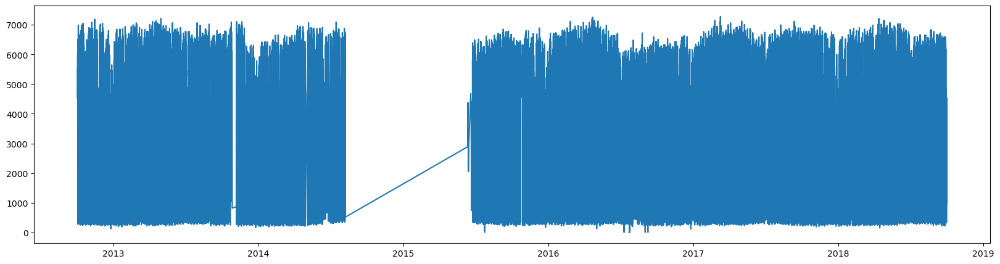

In [10]:
fig, ax = plt.subplots(figsize=(20,5))
ax.plot(data['date_time'], data[target_variable])
# sns.lineplot(data=data, x="Date", y=target_variable, ax=ax)
plt.show()

In [11]:
data.year.value_counts()

year
2017    10605
2016     9306
2013     8573
2018     7949
2014     4839
2015     4373
2012     2559
Name: count, dtype: int64

(200, 14)


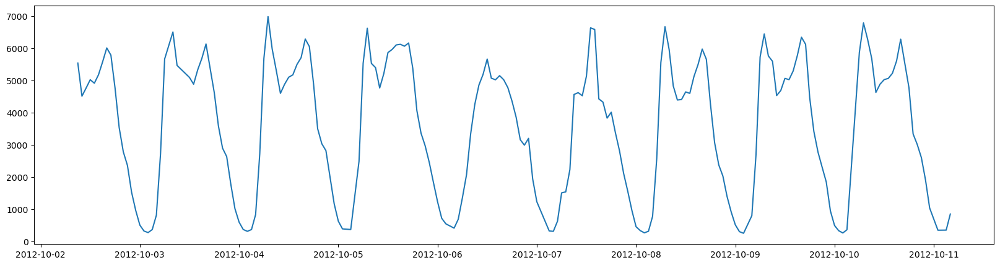

In [12]:
# smaller window of time
fig, ax = plt.subplots(figsize=(20,5))
first_months = data.iloc[:200]
print(first_months.shape)
ax.plot(first_months['date_time'], first_months[target_variable])
plt.show()

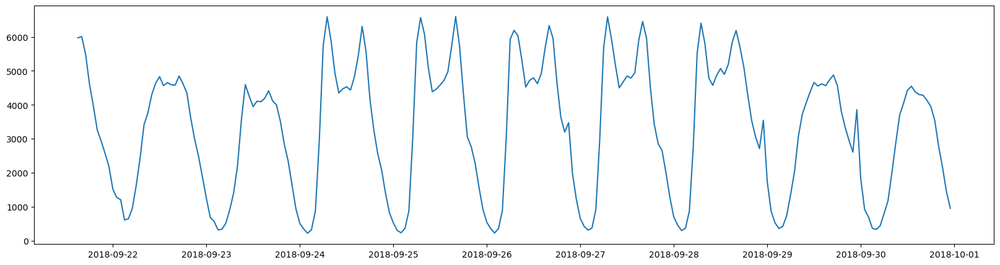

In [13]:
# smaller window of time
fig, ax = plt.subplots(figsize=(20,5))
last_5_days = data.iloc[-240:]
ax.plot(last_5_days['date_time'], last_5_days[target_variable])
plt.show()

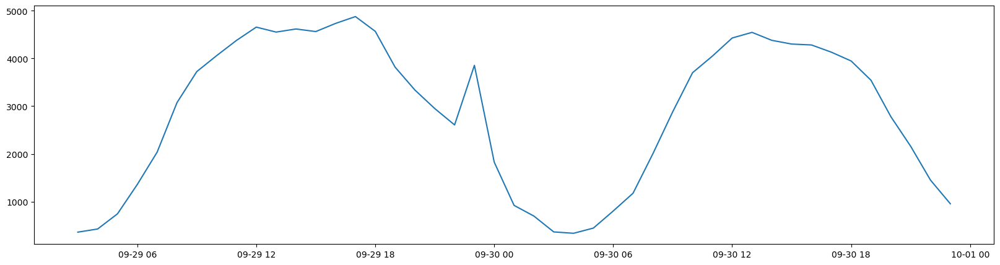

In [14]:
# even smaller window of time
fig, ax = plt.subplots(figsize=(20,5))
last_2_days = data.iloc[-48:]
ax.plot(last_2_days['date_time'], last_2_days[target_variable])
plt.show()

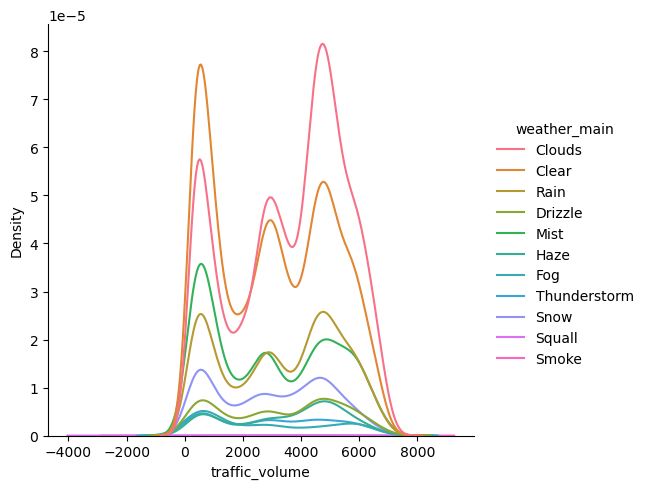

In [15]:
sns.displot(data=data, x="traffic_volume", hue="weather_main", kind="kde")

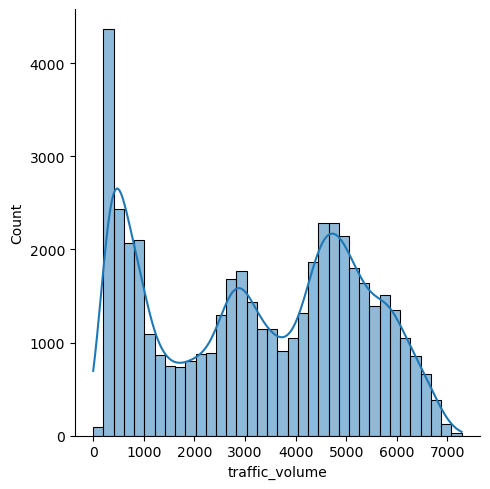

In [16]:
sns.displot(data[target_variable], kde=True);

### Train test split

In [17]:
data.sort_values(by='date_time', inplace=True)
test_size = int(data.shape[0] * 0.2)
train_df = data.iloc[0:-test_size,]
test_df = data.iloc[-test_size:,]

X_train = train_df.drop(columns=[target_variable, 'date_time'], axis=1)
y_train = train_df[target_variable]
X_test = test_df.drop(columns=[target_variable, 'date_time'], axis=1)
y_test = test_df[target_variable]

print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(38564, 12)
(38564,)
(9640, 12)
(9640,)


### Training

In [18]:
def display_metrics(index, y_true, y_hat):
    print(f'Mean absolute error is {round(mean_absolute_error(y_true, y_hat), 4)}')
    print(f'Mean absolute percentage error is {round(mean_absolute_percentage_error(y_true, y_hat), 4)}')
    print(f'Mean square error is {round(mean_squared_error(y_true, y_hat), 4)}')
    print(f'Root mean square error is {round(np.sqrt(mean_squared_error(y_true, y_hat)), 4)}')
    print(f'R2 score is {round(r2_score(y_true, y_hat), 4)}')
    print('\n\n')
    fig, ax = plt.subplots(ncols=2, figsize=(20, 5))
    # plot the residual
    sns.distplot(y_true - y_hat, kde=True, ax=ax[0])

    ax[1].plot(index, y_true, color='blue')
    ax[1].plot(index, y_hat, color='red')
    ax[1].set_ylabel('Acutal Productivity')
    ax[1].set_xlabel('Date')
    ax[1].set_title('Predicted vs Actual')


In [20]:
automl = AutoML(
    ml_task='regression',
    mode='Perform',
    eval_metric='r2',
    results_path='metro-interstate-traffic-volume', 
    total_time_limit=4*3600
)
automl.fit(X_train, y_train)

Linear algorithm was disabled.
AutoML directory: metro-interstate-traffic-volume
The task is regression with evaluation metric r2
AutoML will use algorithms: ['Random Forest', 'LightGBM', 'Xgboost', 'CatBoost', 'Neural Network']
AutoML will ensemble available models
AutoML steps: ['simple_algorithms', 'default_algorithms', 'not_so_random', 'golden_features', 'insert_random_feature', 'features_selection', 'hill_climbing_1', 'hill_climbing_2', 'ensemble']
Skip simple_algorithms because no parameters were generated.
* Step default_algorithms will try to check up to 5 models
1_Default_LightGBM r2 0.985366 trained in 682.16 seconds (1-sample predict time 0.0424 seconds)


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_m

2_Default_Xgboost r2 0.979695 trained in 98.22 seconds (1-sample predict time 0.0355 seconds)
3_Default_CatBoost r2 0.974517 trained in 337.92 seconds (1-sample predict time 0.0265 seconds)
4_Default_NeuralNetwork r2 0.935987 trained in 10.39 seconds (1-sample predict time 0.0495 seconds)
5_Default_RandomForest r2 0.891341 trained in 20.6 seconds (1-sample predict time 0.1127 seconds)
* Step not_so_random will try to check up to 20 models
10_LightGBM r2 0.979757 trained in 562.29 seconds (1-sample predict time 0.0375 seconds)


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_m

6_Xgboost r2 0.983062 trained in 129.06 seconds (1-sample predict time 0.0362 seconds)
14_CatBoost r2 0.977418 trained in 633.68 seconds (1-sample predict time 0.0319 seconds)
18_RandomForest r2 0.862919 trained in 16.48 seconds (1-sample predict time 0.1068 seconds)
22_NeuralNetwork r2 0.927783 trained in 11.53 seconds (1-sample predict time 0.0473 seconds)
11_LightGBM r2 0.980385 trained in 227.51 seconds (1-sample predict time 0.035 seconds)


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_m

7_Xgboost r2 0.98296 trained in 78.71 seconds (1-sample predict time 0.0348 seconds)
15_CatBoost r2 0.963002 trained in 316.72 seconds (1-sample predict time 0.0231 seconds)
19_RandomForest r2 0.834325 trained in 15.29 seconds (1-sample predict time 0.1117 seconds)
23_NeuralNetwork r2 -3.24199 trained in 21.22 seconds (1-sample predict time 0.0482 seconds)
12_LightGBM r2 0.984763 trained in 688.23 seconds (1-sample predict time 0.0411 seconds)


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_m

8_Xgboost r2 0.979666 trained in 132.89 seconds (1-sample predict time 0.0375 seconds)
16_CatBoost r2 0.975823 trained in 327.16 seconds (1-sample predict time 0.0258 seconds)
20_RandomForest r2 0.928497 trained in 27.5 seconds (1-sample predict time 0.1108 seconds)
24_NeuralNetwork r2 -0.784553 trained in 19.2 seconds (1-sample predict time 0.0485 seconds)
13_LightGBM r2 0.98588 trained in 654.14 seconds (1-sample predict time 0.0386 seconds)


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_m

9_Xgboost r2 0.977228 trained in 74.08 seconds (1-sample predict time 0.0349 seconds)
17_CatBoost r2 0.961745 trained in 182.36 seconds (1-sample predict time 0.0216 seconds)
21_RandomForest r2 0.914541 trained in 18.43 seconds (1-sample predict time 0.1135 seconds)
25_NeuralNetwork r2 0.932174 trained in 13.54 seconds (1-sample predict time 0.0492 seconds)
* Step golden_features will try to check up to 3 models
None 10
Add Golden Feature: temp_diff_rain_1h
Add Golden Feature: snow_1h_sum_temp
Add Golden Feature: temp_diff_snow_1h
Add Golden Feature: rain_1h_sum_temp
Add Golden Feature: temp_ratio_clouds_all
Add Golden Feature: clouds_all_multiply_temp
Add Golden Feature: clouds_all_ratio_temp
Add Golden Feature: clouds_all_sum_temp
Add Golden Feature: temp_diff_clouds_all
Add Golden Feature: clouds_all_sum_snow_1h
Created 10 Golden Features in 0.03 seconds.
13_LightGBM_GoldenFeatures r2 0.984765 trained in 612.0 seconds (1-sample predict time 0.0563 seconds)
1_Default_LightGBM_GoldenF

/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_m

28_Xgboost r2 0.981986 trained in 127.51 seconds (1-sample predict time 0.0386 seconds)


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_m

29_Xgboost r2 0.983743 trained in 121.15 seconds (1-sample predict time 0.0372 seconds)


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_m

30_Xgboost r2 0.981559 trained in 81.76 seconds (1-sample predict time 0.0431 seconds)


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_m

31_Xgboost r2 0.983202 trained in 62.01 seconds (1-sample predict time 0.0346 seconds)
32_CatBoost r2 0.976137 trained in 698.25 seconds (1-sample predict time 0.0313 seconds)
33_CatBoost r2 0.976911 trained in 348.5 seconds (1-sample predict time 0.0279 seconds)
34_CatBoost r2 0.976136 trained in 562.73 seconds (1-sample predict time 0.0315 seconds)
35_CatBoost r2 0.974772 trained in 168.42 seconds (1-sample predict time 0.0232 seconds)
36_NeuralNetwork r2 0.929857 trained in 9.55 seconds (1-sample predict time 0.0477 seconds)
37_NeuralNetwork r2 0.86449 trained in 14.11 seconds (1-sample predict time 0.0476 seconds)
38_NeuralNetwork r2 0.677678 trained in 11.46 seconds (1-sample predict time 0.0488 seconds)
39_NeuralNetwork r2 0.909172 trained in 20.62 seconds (1-sample predict time 0.048 seconds)
40_RandomForest r2 0.909595 trained in 16.31 seconds (1-sample predict time 0.1123 seconds)
41_RandomForest r2 0.936939 trained in 19.31 seconds (1-sample predict time 0.1119 seconds)
42_Ra

/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_m

46_Xgboost r2 0.984222 trained in 119.42 seconds (1-sample predict time 0.0362 seconds)


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_m

47_Xgboost r2 0.983805 trained in 94.66 seconds (1-sample predict time 0.0364 seconds)
48_CatBoost r2 0.975208 trained in 152.54 seconds (1-sample predict time 0.0228 seconds)
* Step ensemble will try to check up to 1 model
Ensemble r2 0.986315 trained in 3.27 seconds (1-sample predict time 0.2575 seconds)
AutoML fit time: 12023.37 seconds
AutoML best model: Ensemble


AutoML(eval_metric='r2', ml_task='regression', mode='Perform',
       results_path='metro-interstate-traffic-volume', total_time_limit=14400)

In [21]:
automl.get_leaderboard().sort_values(by=['metric_value']).head(20)

,name,model_type,metric_type,metric_value,train_time,single_prediction_time
51,Ensemble,Ensemble,r2,-0.986315,3.27,0.2575
46,44_LightGBM,LightGBM,r2,-0.985880,622.36,0.0401
20,13_LightGBM,LightGBM,r2,-0.985880,654.65,0.0386
47,45_LightGBM,LightGBM,r2,-0.985851,266.84,0.0427
28,26_LightGBM,LightGBM,r2,-0.985851,267.86,0.0389
0,1_Default_LightGBM,LightGBM,r2,-0.985366,682.68,0.0424
29,27_LightGBM,LightGBM,r2,-0.985251,315.64,0.0351
25,13_LightGBM_GoldenFeatures,LightGBM,r2,-0.984765,612.54,0.0563
15,12_LightGBM,LightGBM,r2,-0.984763,688.75,0.0411
48,46_Xgboost,Xgboost,r2,-0.984222,119.88,0.0362


Mean absolute error is 52.3421
Mean absolute percentage error is 43815705453507.19
Mean square error is 6986.7098
Root mean square error is 83.5865
R2 score is 0.9982





/var/folders/q9/jx0_flz52s507629h4ms15p00000gq/T/ipykernel_32683/2298411725.py:10: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751



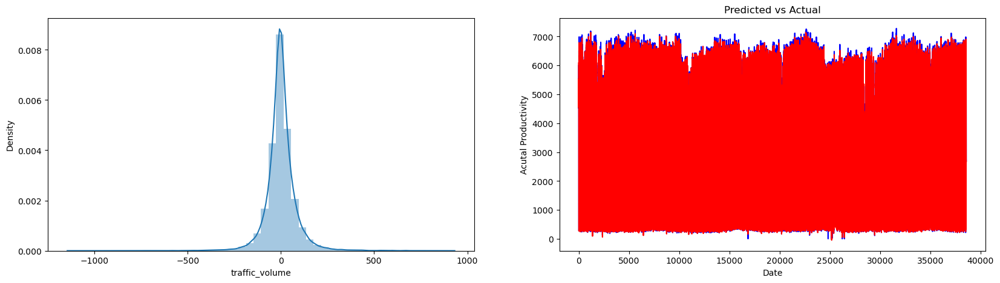

In [22]:
predictions = automl.predict(X_train)
display_metrics(X_train.index, y_train, predictions)

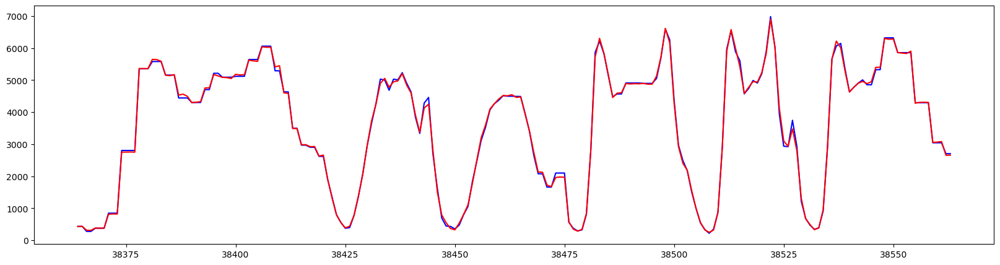

In [23]:
# smaller window of time
fig, ax = plt.subplots(figsize=(20,5))
last_5_days = y_train.iloc[-200:]
ax.plot(last_5_days.index, last_5_days[-200:], color='blue')
ax.plot(last_5_days.index, predictions[-200:], color='red')
plt.show()

### Testing and evaluation

/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/numpy/lib/arraysetops.py:729: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/numpy/lib/arraysetops.py:729: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/numpy/lib/arraysetops.py:729: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/numpy/lib/arraysetops.py:729: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/numpy/lib/arraysetops.py:729: Future

Mean absolute error is 254.1703
Mean absolute percentage error is 0.1271
Mean square error is 191776.4375
Root mean square error is 437.9229
R2 score is 0.9505





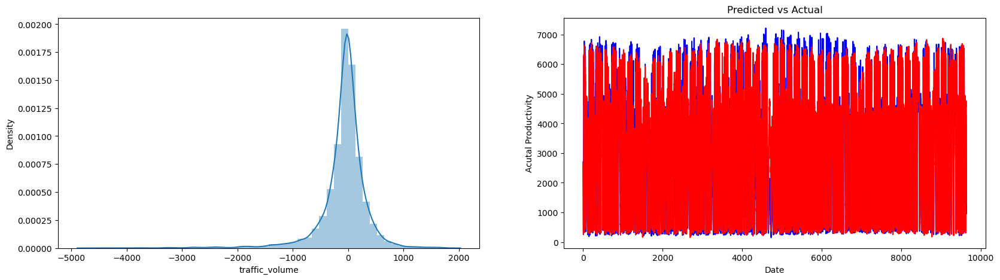

In [24]:
y_hats = automl.predict(X_test)
display_metrics(X_test.index, y_test, y_hats)

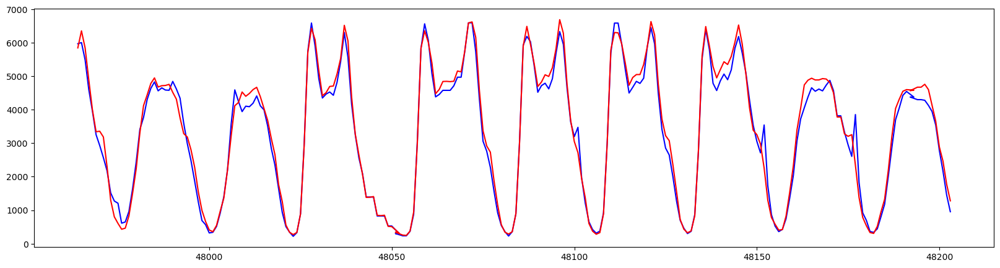

In [25]:
# smaller window of time
fig, ax = plt.subplots(figsize=(20,5))
test_5_days = y_test.iloc[-240:]
ax.plot(test_5_days.index, test_5_days[-240:], color='blue')
ax.plot(test_5_days.index, y_hats[-240:], color='red')
plt.show()

### Report

In [26]:
automl.report()

Best model,name,model_type,metric_type,metric_value,train_time,single_prediction_time
,1_Default_LightGBM,LightGBM,r2,0.985366,682.68,0.0424
,2_Default_Xgboost,Xgboost,r2,0.979695,98.7,0.0355
,3_Default_CatBoost,CatBoost,r2,0.974517,338.42,0.0265
,4_Default_NeuralNetwork,Neural Network,r2,0.935987,10.79,0.0495
,5_Default_RandomForest,Random Forest,r2,0.891341,21.02,0.1127
,10_LightGBM,LightGBM,r2,0.979757,562.86,0.0375
,6_Xgboost,Xgboost,r2,0.983062,129.52,0.0362
,14_CatBoost,CatBoost,r2,0.977418,634.21,0.0319
,18_RandomForest,Random Forest,r2,0.862919,16.91,0.1068
,22_NeuralNetwork,Neural Network,r2,0.927783,11.94,0.0473
